In [2]:
import numpy as np

import pandas as pd
import geopandas as gpd
import contextily as cx

from pathlib import Path

# OLD ROADS - Read maps

## Initial processing

In [3]:
RAW_CARTES_PATH = Path("raw_data/cartes_raw")

GEOJSON_CARTES_PATH = Path("raw_data/cartes_geojson")

EXPORT_DATA = Path("export_data/cartes")

print("RAW")
_ = [print(i) for i in (RAW_CARTES_PATH.glob("**/*.shp"))]
print("\nGEOJSON")
_ = [print(i) for i in (GEOJSON_CARTES_PATH.glob("*"))]


RAW
raw_data\cartes_raw\2021 building-20250219\buildings.shp
raw_data\cartes_raw\Berney\Berney_merge_legende_v6-3bis.shp
raw_data\cartes_raw\cadastre_renove\renove_v1-0.shp
raw_data\cartes_raw\cadastre_vector\merged_melotte.shp
raw_data\cartes_raw\renove_1888\Street_network.shp
raw_data\cartes_raw\renove_1888\Toponimie.shp
raw_data\cartes_raw\roads\roads.shp

GEOJSON
raw_data\cartes_geojson\merged_melotte.geojson
raw_data\cartes_geojson\numeros_renove_merged-v2.json


**Years** :
- `cadastre_vector` = ancien régime
- `Barney` = 1831
- `cadastre_renove` = 1889 (Barney rénové)
- `merged_melotte` = 1727

### Ancien régime (`cadastre_vector`)

Probably useless

c:\Users\arsju\anaconda3\envs\GeoPandas\Lib\site-packages\pyogrio\raw.py:198: RuntimeWarning: raw_data\cartes_raw\cadastre_vector\merged_melotte.shp contains polygon(s) with rings with invalid winding order. Autocorrecting them, but that shapefile should be corrected using ogr2ogr for example.
  return ogr_read(
c:\Users\arsju\anaconda3\envs\GeoPandas\Lib\site-packages\shapely\io.py:320: Warning: Invalid WKB: geometry is returned as None. IllegalArgumentException: point array must contain 0 or >1 elements

  return lib.from_wkb(geometry, invalid_handler, **kwargs)


<Axes: >

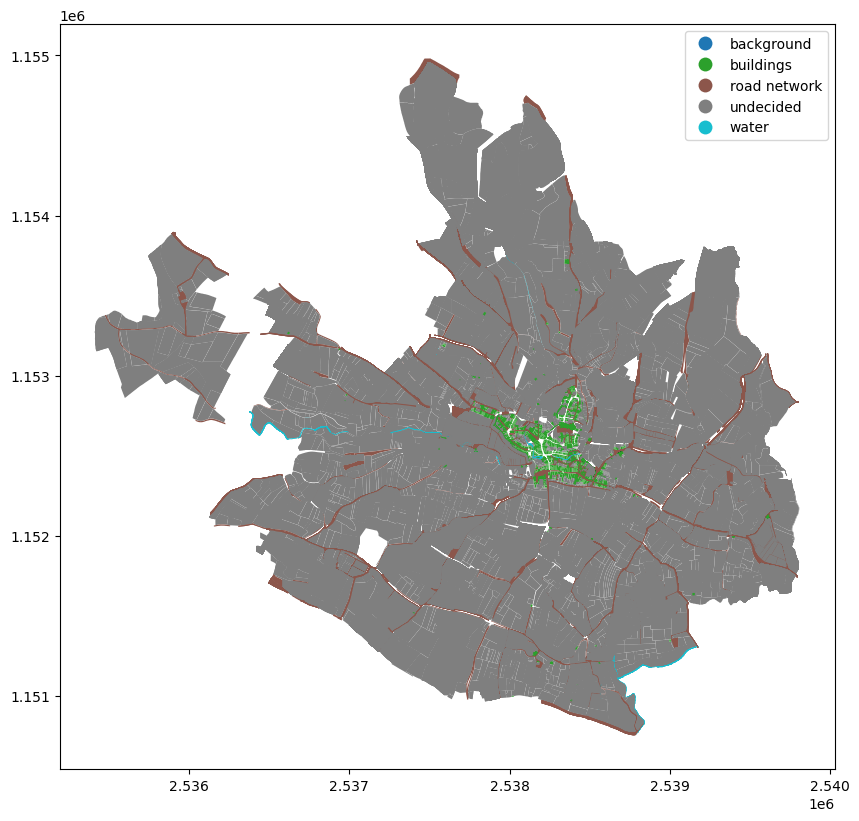

In [5]:
this_path = RAW_CARTES_PATH / "cadastre_vector"
geo_df_1800 = gpd.read_file(this_path, on_invalid="warn")
geo_df_1800.plot(column="class", legend=True, figsize=(10, 10))

In [6]:
geo_df_1800.columns

Index(['class', 'layer', 'path', 'geometry'], dtype='object')

<Axes: >

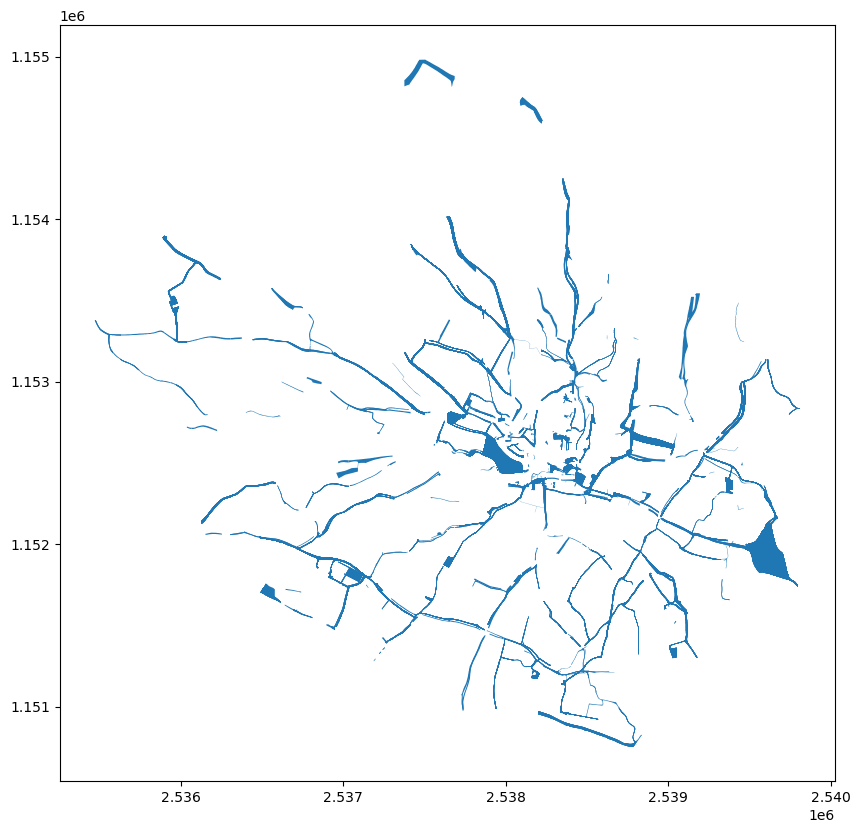

In [90]:
roads_1800 = geo_df_1800[geo_df_1800["class"] == "road network"]
roads_1800.plot(figsize=(10, 10))

In [91]:
geo_df_1800["geometry"].isna().mean()

np.float64(0.32113702623906704)

! We are missing 0.32% of the geometries (invalid). Let's take a look

In [92]:
geo_df_1800[geo_df_1800["geometry"].isna()]

AttributeError: 'NoneType' object has no attribute 'copy'

,class,layer,path,geometry
29,road network,1-2,/Volumes/Samsung_T5/cadasters_processing/shape...,None
30,road network,1-2,/Volumes/Samsung_T5/cadasters_processing/shape...,None
65,buildings,1-2,/Volumes/Samsung_T5/cadasters_processing/shape...,None
66,buildings,1-2,/Volumes/Samsung_T5/cadasters_processing/shape...,None
67,buildings,1-2,/Volumes/Samsung_T5/cadasters_processing/shape...,None
...,...,...,...,...
6854,undecided,B_35-36,/Volumes/Samsung_T5/cadasters_processing/shape...,None
6855,road network,B_35-36,/Volumes/Samsung_T5/cadasters_processing/shape...,None
6856,road network,B_35-36,/Volumes/Samsung_T5/cadasters_processing/shape...,None
6857,road network,B_35-36,/Volumes/Samsung_T5/cadasters_processing/shape...,None


In [93]:
import json

In [94]:
with open(GEOJSON_CARTES_PATH / "merged_melotte.geojson") as f:
    d = json.load(f)
    features = d["features"]

In [95]:
features[29]["geometry"]["coordinates"]

[[[6.635049798207051, 46.52505934356678]]]

In [96]:
df_missing = pd.DataFrame(columns=["geo_type", "Coordinates", "Coordinates_shape", "Class", "Layer"])
for i in geo_df_1800[geo_df_1800["geometry"].isna()].index:
    feature = features[i]
    geometry = np.array(feature["geometry"]["coordinates"])
    df_missing.loc[i] = {
        "geo_type": feature["geometry"]["type"],
        "Coordinates": geometry,
        "Coordinates_shape": geometry.shape,
        "Class": feature["properties"]["class"],
        "Layer": feature["properties"]["layer"]
    }

df_missing

,geo_type,Coordinates,Coordinates_shape,Class,Layer
29,Polygon,"[[[6.635049798207051, 46.52505934356678]]]","(1, 1, 2)",road network,1-2
30,Polygon,"[[[6.635047342871334, 46.52505761367088]]]","(1, 1, 2)",road network,1-2
65,Polygon,"[[[6.635223939503782, 46.52458278817493]]]","(1, 1, 2)",buildings,1-2
66,Polygon,"[[[6.635220665744229, 46.524580481651995]]]","(1, 1, 2)",buildings,1-2
67,Polygon,"[[[6.635218210424762, 46.52457875175975]]]","(1, 1, 2)",buildings,1-2
...,...,...,...,...,...
6854,Polygon,"[[[6.6198078306686154, 46.52414679667508]]]","(1, 1, 2)",undecided,B_35-36
6855,Polygon,"[[[6.62279382603476, 46.52416830870762]]]","(1, 1, 2)",road network,B_35-36
6856,Polygon,"[[[6.623025863798132, 46.52402934332679]]]","(1, 1, 2)",road network,B_35-36
6857,Polygon,"[[[6.623075793900887, 46.523999566463495]]]","(1, 1, 2)",road network,B_35-36


In [103]:
display(df_missing.Coordinates_shape.value_counts())
display(df_missing.geo_type.value_counts())
display(df_missing.Class.value_counts())

Coordinates_shape
(1, 1, 2)    2203
Name: count, dtype: int64

geo_type
Polygon    2203
Name: count, dtype: int64

Class
road network    1438
undecided        369
buildings        352
water             41
background         3
Name: count, dtype: int64

All those "null" values are single points. TO DO : Check whether to include them in the analysis

### 1831 : `Berney`

- `class` : dépend de la couleur sur la carte
- `subclass` : 

<Axes: >

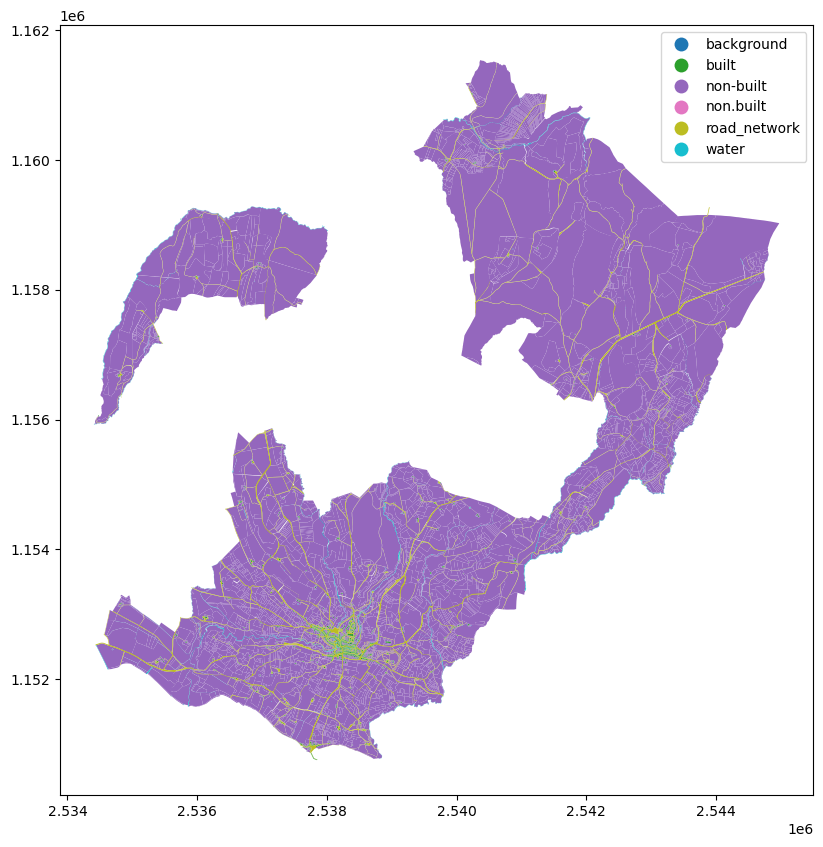

In [5]:
this_path = RAW_CARTES_PATH / "Berney"
geo_df_1830 = gpd.read_file(this_path, on_invalid="warn", encoding="utf-8")
geo_df_1830.crs = 2056

# Clean use
geo_df_1830.use = geo_df_1830.use.str.split("|", expand=True).apply(lambda x: x[0], axis=1).str.strip()
geo_df_1830.plot(column="class", legend=True, figsize=(10, 10))

In [112]:
# List all uses
all_uses = geo_df_1830.use.str.split(",").explode().str.strip().unique()
np.savetxt(EXPORT_DATA / "1839_all_uses.txt", all_uses, fmt='%s')

In [ ]:
uses_road = ["place", "allee publique", "passage", "passage public", "cour", "allee", "place interieure", "pont", "place publique", "place publiques", "promenade publique", "quai neuf", "places", "chemin", "sortie", "avenue"]
geo_df_1830["use_is_road"] = 

In [97]:
geo_df_1830.columns

Index(['class', 'layer', 'path', 'identifier', 'page', 'number', 'subclass',
       'use', 'own_type', 'own_desc', 'own_share', 'own_col_ty', 'own_col_de',
       'own_surnam', 'own_name', 'own_compl', 'geometry'],
      dtype='object')

In [98]:
geo_df_1830.sample(10)

,class,layer,path,identifier,page,number,subclass,use,own_type,own_desc,own_share,own_col_ty,own_col_de,own_surnam,own_name,own_compl,geometry
12177,built,DecoupeBerney_025_modified,/Users/remipetitpierre/Desktop/Cartes/Lausanne...,25029,25.0,29,built,maison,private,Alexandre-François-Vincent Perdonnet,nan,nan,nan,Alexandre-François-Vincent,Perdonnet,nan,"POLYGON ((2538916.525 1152103.786, 2538916.083..."
5302,non-built,DecoupeBerney_041,/Users/remipetitpierre/Desktop/Cartes/Lausanne...,None,NaN,None,non-built,None,None,None,None,None,None,None,None,None,"POLYGON ((2537602.384 1151363.548, 2537601.779..."
3715,non-built,DecoupeBerney_008,/Users/remipetitpierre/Desktop/Cartes/Lausanne...,8343,8.0,343,non_built_residential,jardin,public_collectivity,Commune de Lausanne,nan,nan,nan,nan,nan,nan,"POLYGON ((2538271.957 1152630.665, 2538271.883..."
395,built,DecoupeBerney_003,/Users/remipetitpierre/Desktop/Cartes/Lausanne...,None,NaN,None,built,None,None,None,None,None,None,None,None,None,"POLYGON ((2538355.738 1152423.274, 2538354.679..."
592,built,DecoupeBerney_004,/Users/remipetitpierre/Desktop/Cartes/Lausanne...,4168,4.0,168,built,"écurie, chambre à resserrer",private,Jacob Hansjacob fils d'André,nan,nan,nan,Jacob,Hansjacob,fils d'André,"POLYGON ((2538596.653 1152346.059, 2538596.577..."
14243,road_network,None,None,None,NaN,None,road_network,None,None,None,None,None,None,None,None,None,"POLYGON ((2537606.676 1151819.572, 2537610.74 ..."
13564,built,DecoupeBerney_116_modified,/Users/remipetitpierre/Desktop/Cartes/Lausanne...,None,NaN,None,built,None,None,None,None,None,None,None,None,None,"POLYGON ((2540007.171 1152663.379, 2540004.753..."
9714,road_network,DecoupeBerney_013,/Users/remipetitpierre/Desktop/Cartes/Lausanne...,None,NaN,None,road_network,None,None,None,None,None,None,None,None,None,"POLYGON ((2538073.222 1152879.515, 2538073.956..."
4218,non-built,DecoupeBerney_014,/Users/remipetitpierre/Desktop/Cartes/Lausanne...,14001,14.0,1,non_built_forestry,bois,private,Jean-Jacob-Samuel Sider fils de Rodolph,nan,nan,nan,Jean-Jacob-Samuel,Sider,fils de Rodolph,"POLYGON ((2538202.347 1153171.905, 2538201.749..."
11018,water,DecoupeBerney_136,/Users/remipetitpierre/Desktop/Cartes/Lausanne...,None,NaN,None,water,None,None,None,None,None,None,None,None,None,"POLYGON ((2540369.083 1160321.856, 2540369.7 1..."


In [99]:
geo_df_1830["geometry"].isna().mean()

np.float64(0.00027892057736559516)

#### Extract roads

<Axes: >

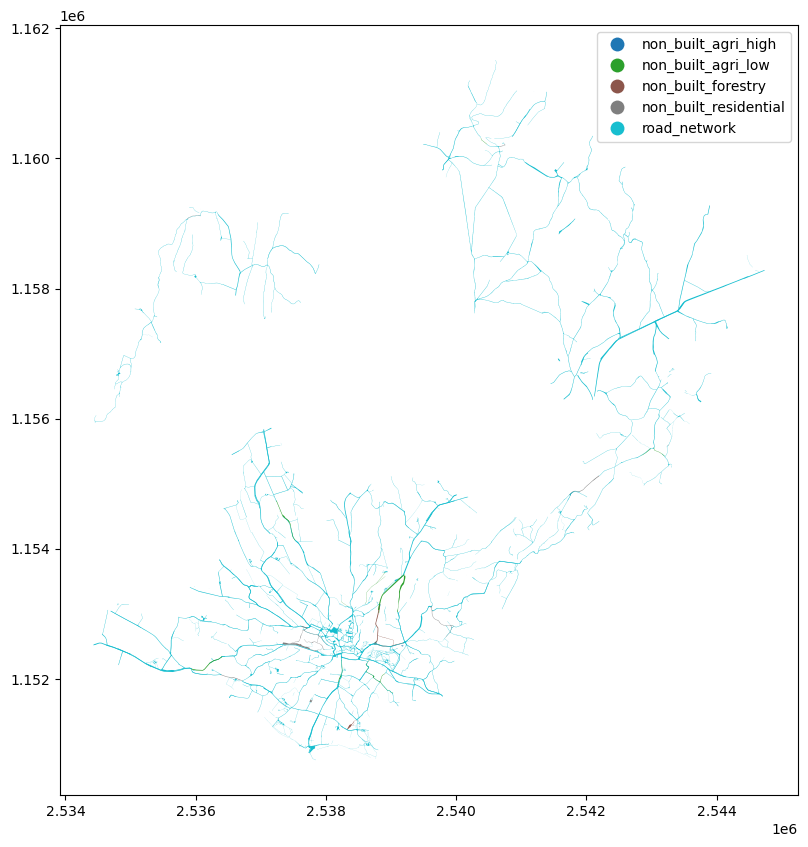

In [6]:
roads_1830 = geo_df_1830[(geo_df_1830["class"] == "road_network")]
roads_1830.plot(column = "subclass", legend = True, figsize=(10, 10))

In [101]:
roads_1830[["class", "subclass", "use"]].astype("str").value_counts().to_csv(EXPORT_DATA / "1830_roads_use.csv")

In [27]:
roads_1830.isna().mean()

np.float64(0.0008012820512820513)

In [ ]:
roads_1830.to_file(EXPORT_DATA / "1831_roads.geojson")

In [ ]:
roads_1830.to_file?

In [9]:
fol = roads_1830.explore(tiles=None)

In [14]:
fol.save(EXPORT_DATA / "1831_roads.html")

#### Extract bati / non-bati

In [32]:
geo_df_1830["class"].value_counts()

class
non-built       8433
built           3186
water           1472
road_network    1248
background         1
non.built          1
Name: count, dtype: int64

In [36]:
geo_df_1830["subclass"].value_counts()

subclass
built                    3024
non-built                2990
road_network             2392
non_built_agri_low       2188
water                    1464
non_built_residential    1005
non_built_forestry        645
non_built_agri_high       631
background                  1
non.built                   1
Name: count, dtype: int64

In [37]:
geo_df_1830[["class", "subclass"]].value_counts()

class         subclass             
built         built                    3024
non-built     non-built                2990
              non_built_agri_low       2163
water         water                    1464
road_network  road_network             1219
non-built     road_network             1079
              non_built_residential     939
              non_built_forestry        635
              non_built_agri_high       627
built         road_network               92
              non_built_residential      58
road_network  non_built_agri_low         15
              non_built_residential       8
built         non_built_agri_low          8
road_network  non_built_forestry          4
water         non_built_forestry          4
              non_built_agri_low          2
built         non_built_agri_high         2
              non_built_forestry          2
water         road_network                2
road_network  non_built_agri_high         2
background    background                

### 1886 - 1888 : `cadastre_renove`

c:\Users\arsju\anaconda3\envs\GeoPandas\Lib\site-packages\pyogrio\geopandas.py:265: UserWarning: More than one layer found in 'renove_1888': 'Street_network' (default), 'Toponimie'. Specify layer parameter to avoid this warning.
  result = read_func(
C:\Users\arsju\AppData\Local\Temp\ipykernel_33312\2785356265.py:3: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  road_net_df_1880.plot(column="class", legend=True, figsize=(10, 10))


<Axes: >

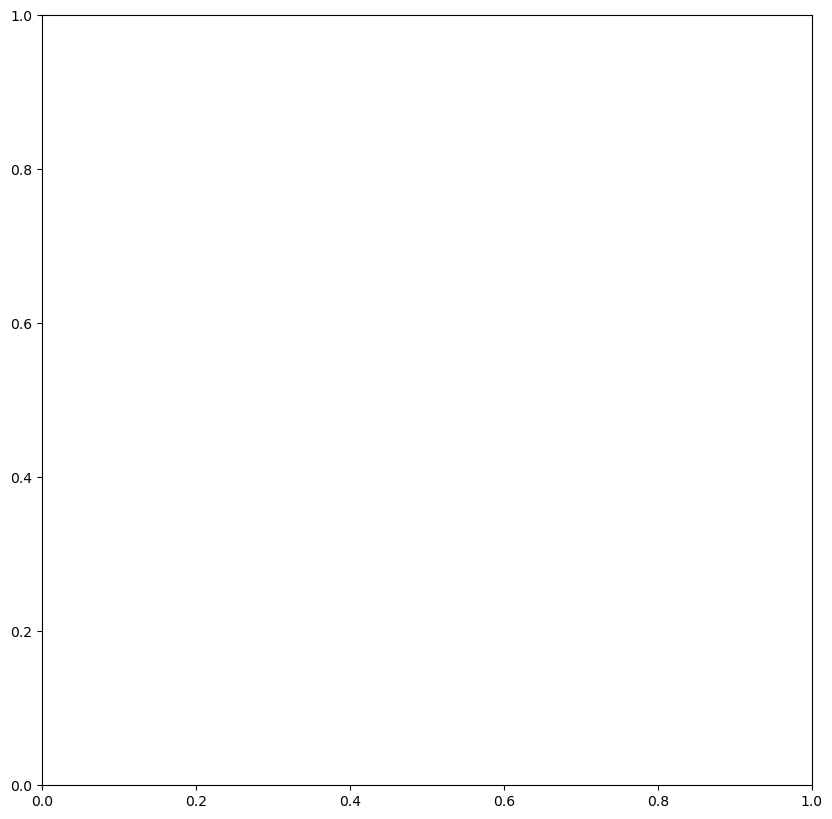

In [4]:
this_path = RAW_CARTES_PATH / "renove_1888"
road_net_df_1880 = gpd.read_file(this_path, on_invalid="warn")
road_net_df_1880.plot(column="class", legend=True, figsize=(10, 10))

<Axes: >

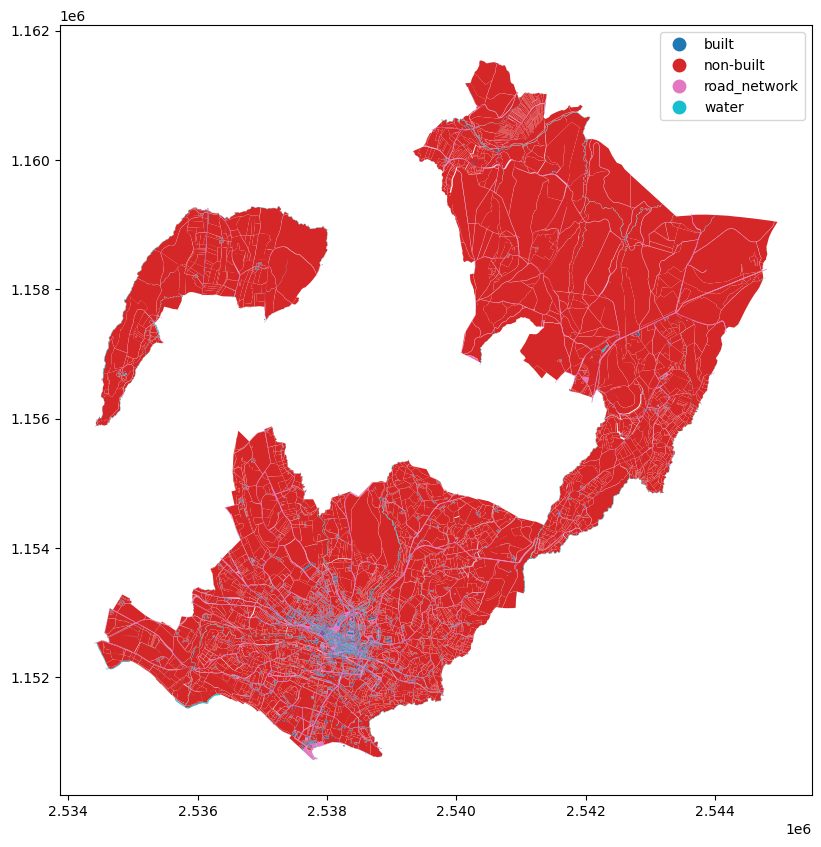

In [11]:
this_path = RAW_CARTES_PATH / "cadastre_renove"
geo_df_1880 = gpd.read_file(this_path, on_invalid="warn")
geo_df_1880.plot(column="class", legend=True, figsize=(10, 10))

<Axes: >

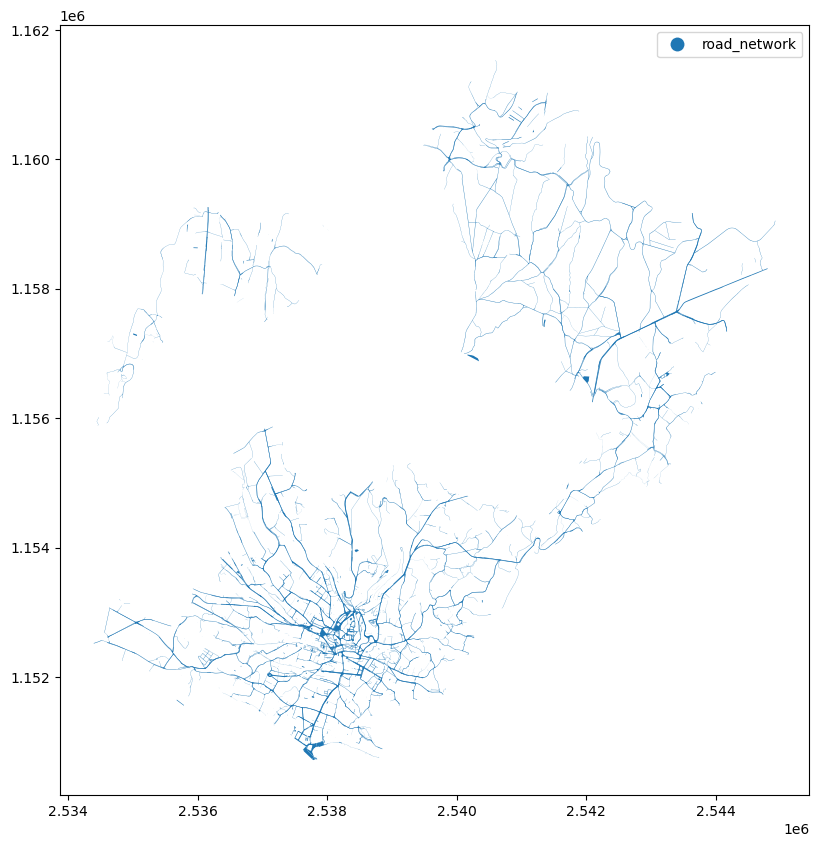

In [12]:
roads_1880 = geo_df_1880[geo_df_1880["class"] == "road_network"]
roads_1880.plot(column="class", legend=True, figsize=(10, 10))

In [13]:
geo_df_1880["geometry"].isna().mean()

np.float64(0.0)

In [14]:
geo_df_1880.columns

Index(['class', 'layer', 'geometry'], dtype='object')

### Comparison

In [113]:
roads_1800.crs, roads_1830.crs, roads_1880.crs

(<Projected CRS: EPSG:2056>
 Name: CH1903+ / LV95
 Axis Info [cartesian]:
 - E[east]: Easting (metre)
 - N[north]: Northing (metre)
 Area of Use:
 - name: Liechtenstein; Switzerland.
 - bounds: (5.96, 45.82, 10.49, 47.81)
 Coordinate Operation:
 - name: Swiss Oblique Mercator 1995
 - method: Hotine Oblique Mercator (variant B)
 Datum: CH1903+
 - Ellipsoid: Bessel 1841
 - Prime Meridian: Greenwich,
 None,
 <Projected CRS: EPSG:2056>
 Name: CH1903+ / LV95
 Axis Info [cartesian]:
 - E[east]: Easting (metre)
 - N[north]: Northing (metre)
 Area of Use:
 - name: Liechtenstein; Switzerland.
 - bounds: (5.96, 45.82, 10.49, 47.81)
 Coordinate Operation:
 - name: Swiss Oblique Mercator 1995
 - method: Hotine Oblique Mercator (variant B)
 Datum: CH1903+
 - Ellipsoid: Bessel 1841
 - Prime Meridian: Greenwich)

c:\Users\arsju\anaconda3\envs\GeoPandas\Lib\site-packages\geopandas\geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
c:\Users\arsju\anaconda3\envs\GeoPandas\Lib\site-packages\geopandas\array.py:1638: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as CH1903+ / LV95 (the single non-null crs provided).
  return GeometryArray(data, crs=_get_common_crs(to_concat))


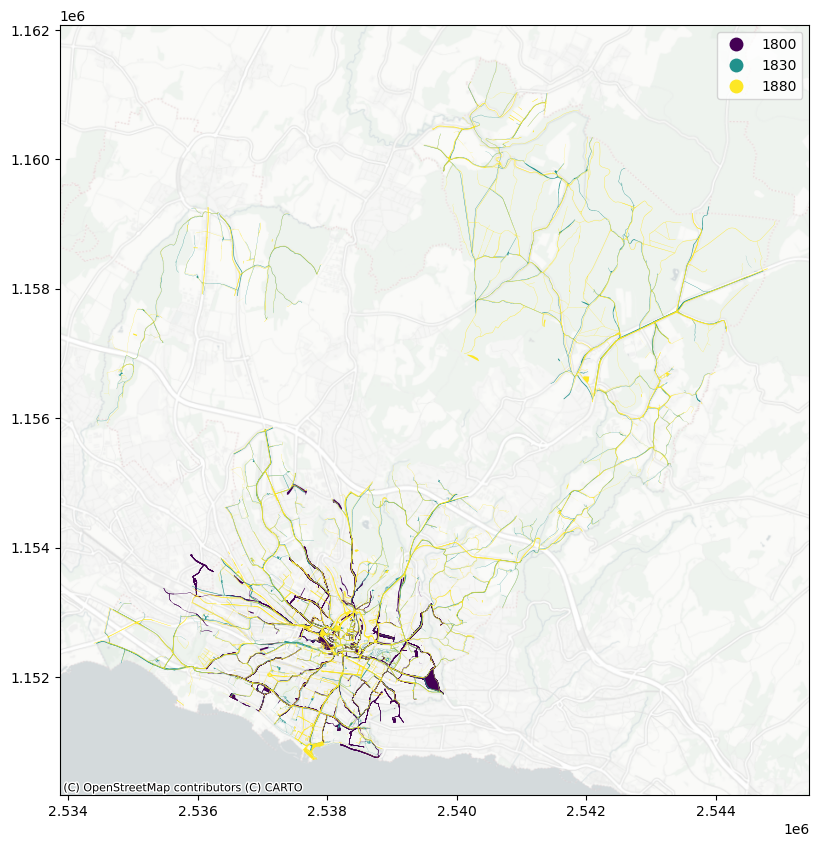

In [142]:
roads_1800["Year"] = "1800"
roads_1830["Year"] = "1830"
roads_1880["Year"] = "1880"

old_roads = pd.concat([roads_1800, roads_1830, roads_1880])

ax = old_roads.plot(column="Year", legend = True, figsize = (10,10), cmap="viridis")
cx.add_basemap(ax, crs = old_roads.crs, source = "CartoDB PositronNoLabels")

In [145]:
# Interactive
old_roads.explore(column="Year", legend = True, figsize = (10,10), cmap="viridis", tiles="CartoDB PositronNoLabels")

In [149]:
roads_1800.total_bounds

array([2535472.40043429, 1150753.62338845, 2539807.76538205,
       1154982.6803701 ])

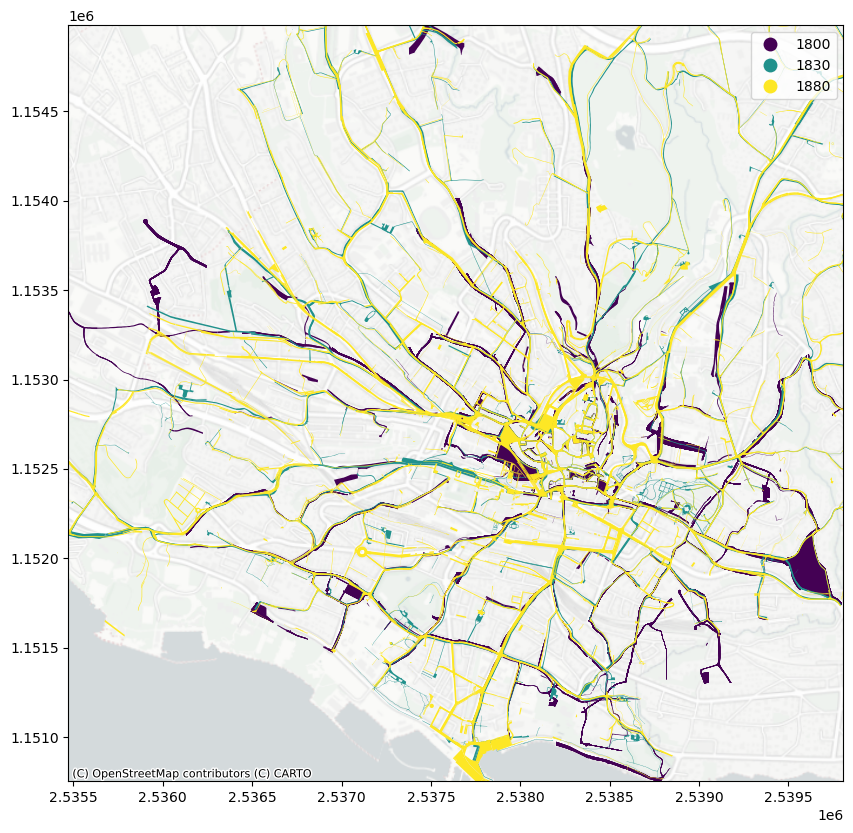

In [153]:
# Zoom sur Lausanne
ax = old_roads.plot(column="Year", legend = True, figsize = (10,10), cmap="viridis")
ax.set_xlim(roads_1800.total_bounds[[0, 2]])
ax.set_ylim(roads_1800.total_bounds[[1, 3]])
cx.add_basemap(ax, crs = old_roads.crs, source = "CartoDB PositronNoLabels")

In [118]:
old_roads.plot?

Signature:      old_roads.plot(*args, **kwargs)
Type:           GeoplotAccessor
String form:    <geopandas.plotting.GeoplotAccessor object at 0x00000236A4BABE30>
File:           c:\users\arsju\anaconda3\envs\geopandas\lib\site-packages\geopandas\plotting.py
Docstring:     
Plot a GeoDataFrame.

Generate a plot of a GeoDataFrame with matplotlib.  If a
column is specified, the plot coloring will be based on values
in that column.

Parameters
----------
column : str, np.array, pd.Series (default None)
    The name of the dataframe column, np.array, or pd.Series to be plotted.
    If np.array or pd.Series are used then it must have same length as
    dataframe. Values are used to color the plot. Ignored if `color` is
    also set.
kind: str
    The kind of plots to produce. The default is to create a map ("geo").
    Other supported kinds of plots from pandas:

    - 'line' : line plot
    - 'bar' : vertical bar plot
    - 'barh' : horizontal bar plot
    - 'hist' : histogram
    - 'box' :

### 2021